In [ ]:
# default_exp tutorial.calibration_files

# Tutorial: How to calibrate the OpenHSI camera


> Warning: This is not for genral use.

In [ ]:
#all_hardware

In [ ]:
from openhsi.calibrate import SettingsBuilderMixin, sum_gaussians, specta_pt_contoller
from openhsi.cameras import LucidCamera
import numpy as np

import holoviews as hv
hv.extension('bokeh',logo=False)
import panel as pn

class CalibrateLucidCamera(SettingsBuilderMixin,LucidCamera):
    pass

# json_path='cals/cam_settings_lucid_214302972.json'
# pkl_path="cals/openhsi_214302972.pkl"

json_path='cals/cam_settings_lucid_template.json'
pkl_path=''

modelno=6
print("".format(modelno))

json_path_target='cals/OpenHSI-0{0:01d}/OpenHSI-0{0:01d}_settings_Mono8_bin1.json'.format(modelno)
pkl_path_target='cals/OpenHSI-0{0:01d}/OpenHSI-0{0:01d}_calibration_Mono8_bin1.pkl'.format(modelno)

spt=specta_pt_contoller()

## Find illuminated sensor area

The vertical directon/y axis of the detector array corrspeonds the across-track direction of the sensor. If the image of slit is shorter then the heigh we can crop the top and bottom to save bandwidth/disk space (similar to letterboxing video).

There are two ways to do this, croping after the fact using row_minmax or by setting up a window on the sensor. Setting up a window will reduce the ammount of data transfered from the sensor and can improve maximum framerate depending on the sensor so is recomended.

### 1. Take a flat field

First step is to provide a uniform illumination to the slit, ideally spectrally broadband, like a halogen lamp or the sun.

In [ ]:
spt.selectPreset(10000)

with CalibrateLucidCamera(json_path=json_path,
                     pkl_path="",
                     processing_lvl=-1,
                    ) as cam:
    
    hvim_flat=cam.retake_flat_field(show=True)
    hvim_flat.opts(width=600,height=600,axiswise=True)
    
    hvim_row_minmax=cam.update_row_minmax()
    hvim_row_minmax.opts(width=600,height=600,axiswise=True)
    
    # Use Row min max to update window
    windowheight=int(np.ceil((cam.settings["row_slice"][1]-cam.settings["row_slice"][0]) / 4.) * 4)
    print("Windowheight {}".format(windowheight))

    cam.settings["win_resolution"]=[windowheight+16, cam.settings["resolution"][1]]
    cam.settings["win_offset"]=[int(np.ceil((cam.settings["row_slice"][0]) / 4.)*4)-8, cam.settings["win_offset"][1]]
    
    cam.settings["row_slice"]=[16, windowheight-16]
    
    cam.settings["resolution"] = cam.settings["win_resolution"]
    cam.dump(json_path=json_path_target,pkl_path=pkl_path_target)
    
# spt.selectPreset(1000)
hvim_row_minmax+hvim_flat


Locs row_min: 100 and row_max: 1013
Windowheight 908


:Layout
   .Overlay.I :Overlay
      .Curve.I      :Curve   [x]   (y)
      .Curve.A_104  :Curve   [x]   (y)
      .Curve.A_1009 :Curve   [x]   (y)
   .Image.I   :Image   [x,y]   (z)

### 2. Take Arc and setup wavelength scale, and get window for 430 to 900nm

155.16666666666666


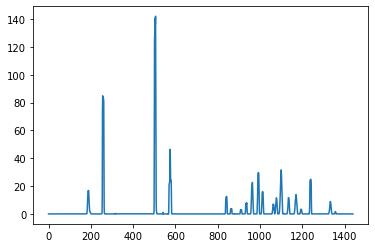

Peak 0 at col 503.8528469946706 - default wavelength 546.96:


Peak 1 at col 258.16610173626043 - default wavelength 435.833:


Peak 2 at col 575.1157697250338 - default wavelength 579.513:


Peak 3 at col 991.9033366037993 - default wavelength 763.511:


[2 1 3 6]
[158.6340253   98.08873879  38.36966676  32.99160234]
[503.85284699 258.16610174 575.11576973 991.9033366 ]
[3.69635682 3.78424799 4.99501548 3.81013958]
[546.96, 435.833, 579.513, 763.511]


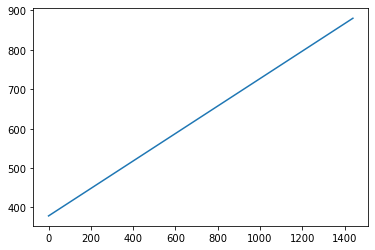

Window Width 1240, offset x 204


In [ ]:
#hardware

with CalibrateLucidCamera(json_path=json_path_target,
                     pkl_path="",
                     processing_lvl=-1,
                    ) as cam:
    cam.deviceSettings['Gain'].value=11.
    hvimg=cam.retake_HgAr(show=True,numframes=18)

    hvimg.opts(width=600,height=600)
    print(cam.calibration["HgAr_pic"].max())
    smile_fit_hv=cam.update_smile_shifts()
    
    cam.calibration["smile_shifts"] = cam.calibration["smile_shifts"]*0

    wavefit_hv=cam.fit_HgAr_lines(top_k=10, 
                                  brightest_peaks=[546.96, 435.833,(579.960+579.066)/2, 763.511],
                                  find_peaks_height=10,
                                  prominence=None,
                                  width=1,
                                  interactive_peak_id=True) #[435.833,546.074,(579.960+579.066)/2,763.511]
    
    # Use wavecal to narrow spetral range.
    waveminmax=[430,900]
    waveminmax_ind = [np.argmin(np.abs(cam.calibration["wavelengths_linear"]-λ)) for λ in waveminmax]

    window_width = int(np.ceil((waveminmax_ind[1]-waveminmax_ind[0] + 8) / 4.) * 4)
    offset_x = int(np.floor((waveminmax_ind[0]-4) / 4.)*4)
    print("Window Width {}, offset x {}".format(window_width,offset_x))

    cam.settings["win_resolution"][1]=window_width
    cam.settings["win_offset"][1]= offset_x

    pn.Column(hvimg,smile_fit_hv, wavefit_hv.opts(xlim=(400,900),ylim=(-10,255)).opts(shared_axes=False))

In [ ]:
pn.Column(hvimg,smile_fit_hv, wavefit_hv.opts(xlim=(400,900),ylim=(-10,255)).opts(shared_axes=False))

Column
    [0] HoloViews(Image)
    [1] HoloViews(Curve)
    [2] HoloViews(Overlay)

In [ ]:
cam.dump(json_path=json_path_target,pkl_path=pkl_path_target)

### 3. Retake flat field and arc with windows

In [ ]:
spt.selectPreset(10000)

with CalibrateLucidCamera(json_path=json_path_target,
                     pkl_path=pkl_path_target,
                     processing_lvl=-1,
                    ) as cam:
    cam.deviceSettings['Gain'].value=10.
    hvim_flat=cam.retake_flat_field(show=True)
    hvim_flat.opts(width=600,height=600,axiswise=True)
    
    hvim_row_minmax=cam.update_row_minmax()
    hvim_row_minmax.opts(width=600,height=600,axiswise=True)
    
    cam.update_resolution()
    cam.dump(json_path=json_path_target,pkl_path=pkl_path_target)

# spt.turnOffLamp()

hvim_row_minmax+hvim_flat

Locs row_min: 4 and row_max: 917


:Layout
   .Overlay.I :Overlay
      .Curve.I     :Curve   [x]   (y)
      .Curve.A_8   :Curve   [x]   (y)
      .Curve.A_913 :Curve   [x]   (y)
   .Image.I   :Image   [x,y]   (z)

### Redo Arc with window.

145.7


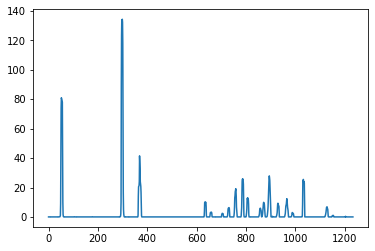

Peak 0 at col 298.4255062893739 - default wavelength 546.96:


Peak 1 at col 53.49321708491116 - default wavelength 435.833:


Peak 2 at col 369.76936401433164 - default wavelength 579.513:


Peak 3 at col 787.2917941915065 - default wavelength 763.511:


[1 0 2 5]
[152.27843079  92.13966376  34.99844853  28.94246855]
[298.42550629  53.49321708 369.76936401 787.29179419]
[3.73925276 3.77922501 5.00587549 3.77754796]
[546.96, 435.833, 579.513, 763.511]


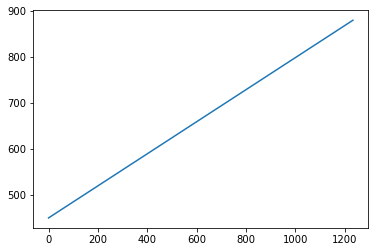

NameError: name 'hvimg' is not defined

In [ ]:
with CalibrateLucidCamera(json_path=json_path_target,
                     pkl_path=pkl_path_target,
                     processing_lvl=-1,
                    ) as cam:
    cam.deviceSettings['Gain'].value=11.
    # hvimg=cam.retake_HgAr(show=True)

    # hvimg.opts(width=400,height=400)
    print(cam.calibration["HgAr_pic"].max())
    smile_fit_hv=cam.update_smile_shifts()

    wavefit_hv=cam.fit_HgAr_lines(top_k=10, 
                                  brightest_peaks=[546.96, 435.833,(579.960+579.066)/2, 763.511],
                                  find_peaks_height=10,
                                  prominence=0.1,
                                  width=1.5,
                                  interactive_peak_id=True) #[435.833,546.074,(579.960+579.066)/2,763.511]


(hvimg + smile_fit_hv + wavefit_hv.opts(xlim=(400,900),ylim=(-10,255))).opts(shared_axes=False)

In [ ]:
cam.dump(json_path=json_path_target,pkl_path=pkl_path_target)

### 3. Get Integrating Sphere data for radiance calibration

4D datacube with coordinates of cross-track, wavelength, exposure, and luminance.

In [ ]:
lum_preset_dict={0:1, 1000:2, 2000:3, 3000:4, 4000:5, 5000:6, 6000:7, 7000:8, 8000:9, 9000:10, 10000:11, 20000:12, 25000:13, 30000:15, 35000:15, 40000:16}

lum_preset_dict={0:1, 1000:2, 2000:3, 4000:5, 6000:7, 8000:9, 10000:11}


luminances = np.fromiter(lum_preset_dict.keys(), dtype=int)
luminances = np.append(luminances,0)
exposures = [0, 5, 8, 10, 15, 20]

with CalibrateLucidCamera(json_path=json_path_target,
                     pkl_path=pkl_path_target,
                     processing_lvl=-1,
                    ) as cam:
    
    cam.calibration["rad_ref"] = cam.update_intsphere_cube(exposures, luminances, noframe=10, lum_chg_func=print)
    cam.dump(json_path=json_path_target,pkl_path=pkl_path_target)

spt.turnOffLamp()

Luminance = 0 Cd/m^2. Place lens cap on and press enter to continue. 
Luminance = 0 Cd/m^2. Remove lens cap and place on int sphere and press enter to continue. 


1000
2000
4000
6000
8000
10000


Luminance = 0 Cd/m^2. Place lens cap on and press enter to continue. 
Luminance = 0 Cd/m^2. Remove lens cap and place on int sphere and press enter to continue. 


ConnectionRefusedError: [WinError 10061] No connection could be made because the target machine actively refused it

In [ ]:

luminances

array([    0,  1000,  2000,  4000,  6000,  8000, 10000, 20000, 30000,
       35000, 40000])

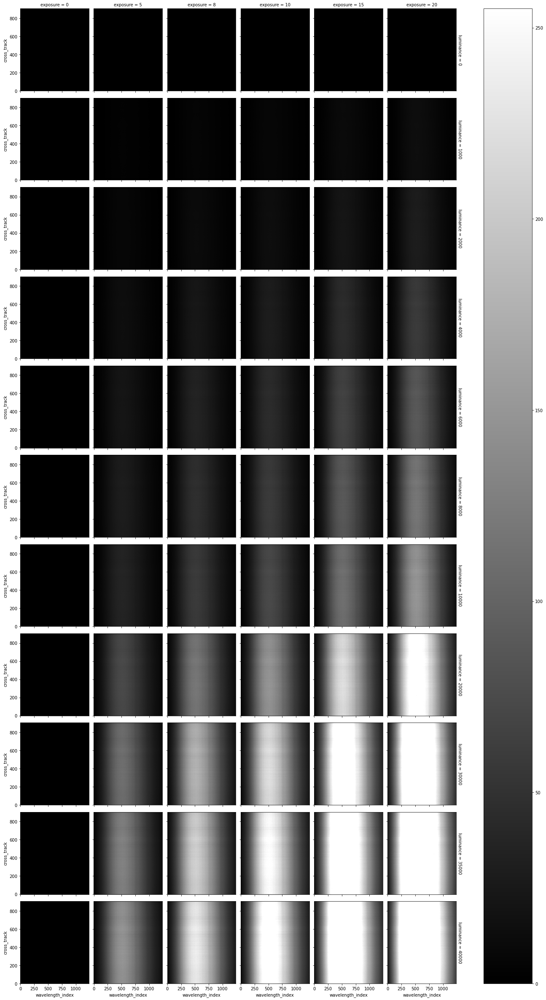

In [ ]:
cam.calibration["rad_ref"].plot(y="cross_track", x="wavelength_index", col="exposure", row="luminance",cmap="gray")

In [ ]:
print("rad_ref is {} MB".format(cam.calibration["rad_ref"].size/1024/1024 *4))

rad_ref is 282.53631591796875 MB


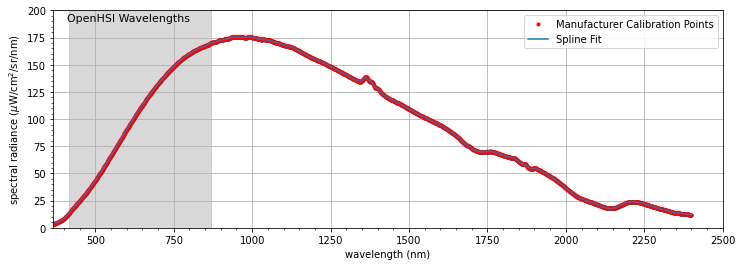

In [ ]:
cam.update_intsphere_fit()
cam.dump(json_path=json_path_target,pkl_path=pkl_path_target)